# Поиск решения в большой лабораторной работе

 Ниже находятся некоторые рассуждения, которые возникали в процессе написания алгоритма. Этот код необязательно читать и ревьюить. Здесь я пробовала различные функции/методы для того, чтобы сформировался нормальный код большой лабораторной работы

In [3]:
from matplotlib import pyplot as plt
from matplotlib import cm
from matplotlib.patches import Rectangle
from imageio import imread, imsave
import numpy as np
from skimage.color import rgb2gray
from skimage.feature import canny
from skimage.filters import gaussian
from skimage.filters import try_all_threshold
from skimage.filters import threshold_otsu, threshold_triangle, rank
from skimage.morphology import binary_closing
from skimage.morphology import binary_opening
from skimage.morphology import disk
from skimage.transform import (hough_line, hough_line_peaks, probabilistic_hough_line)
from skimage.util import img_as_ubyte
import cv2

In [4]:
data_path = "..\\SG_Big_Lab_SPBPU_2020\\Data"

Рассмотрим работу на примере одного изображения

In [5]:
name_img = "yes_01.jpg"
data_img = imread("%s\\%s" % (data_path, name_img))
data_img_gray = rgb2gray(data_img)

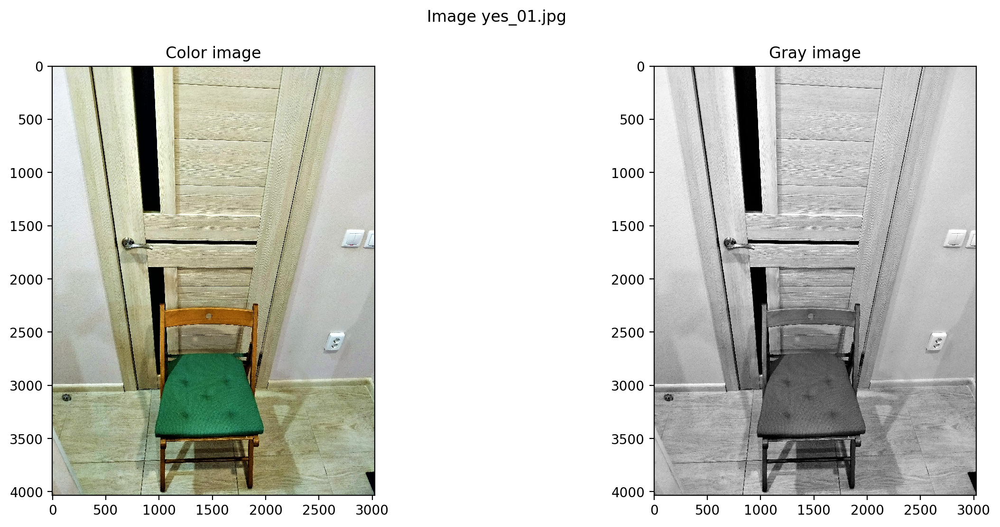

In [6]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6))
fig.set_dpi(200)  
fig.suptitle("Image %s" % name_img)
ax[0].set_title('Color image')
ax[0].imshow(data_img)
ax[1].set_title('Gray image')
ax[1].imshow(data_img_gray, cmap='gray')

#### Метод Canny

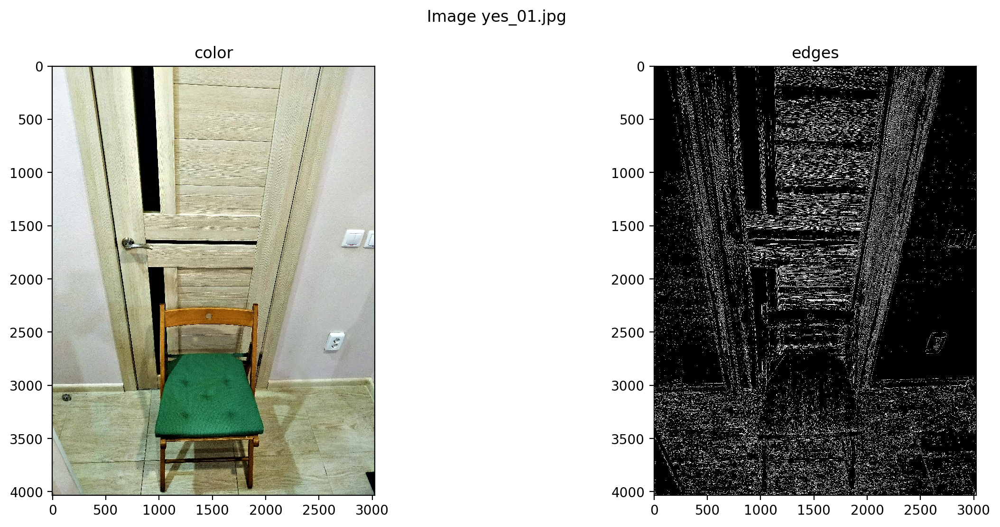

In [7]:
edges = canny(data_img_gray, sigma=1)
fig, ax = plt.subplots(1, 2, figsize=(15, 6))
fig.set_dpi(200)
fig.suptitle("Image %s" % name_img)
ax[0].set_title('color')
ax[0].imshow(data_img)
ax[1].set_title('edges')
ax[1].imshow(edges, cmap="gray")

Видно, что метод Canny работает крайне плохо. Очень трудно разобрать, где находится стул.

#### Бинаризация

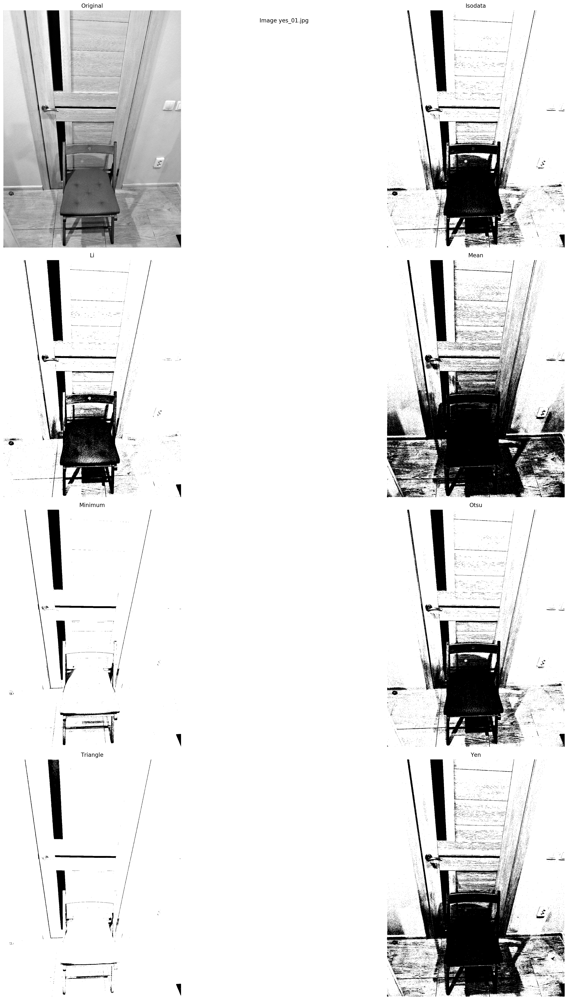

In [8]:
fig, ax = try_all_threshold(data_img_gray, figsize=(30, 30), verbose=False)
fig.set_dpi(200)
fig.suptitle("Image %s" % name_img)
plt.show()

Неплохо выглядит Li

#### Морфологические функции

In [9]:
img = img_as_ubyte(data_img_gray)
radius = 15
loc_otsu = rank.otsu(img, disk(radius))
img_loc_otsu = img >= loc_otsu

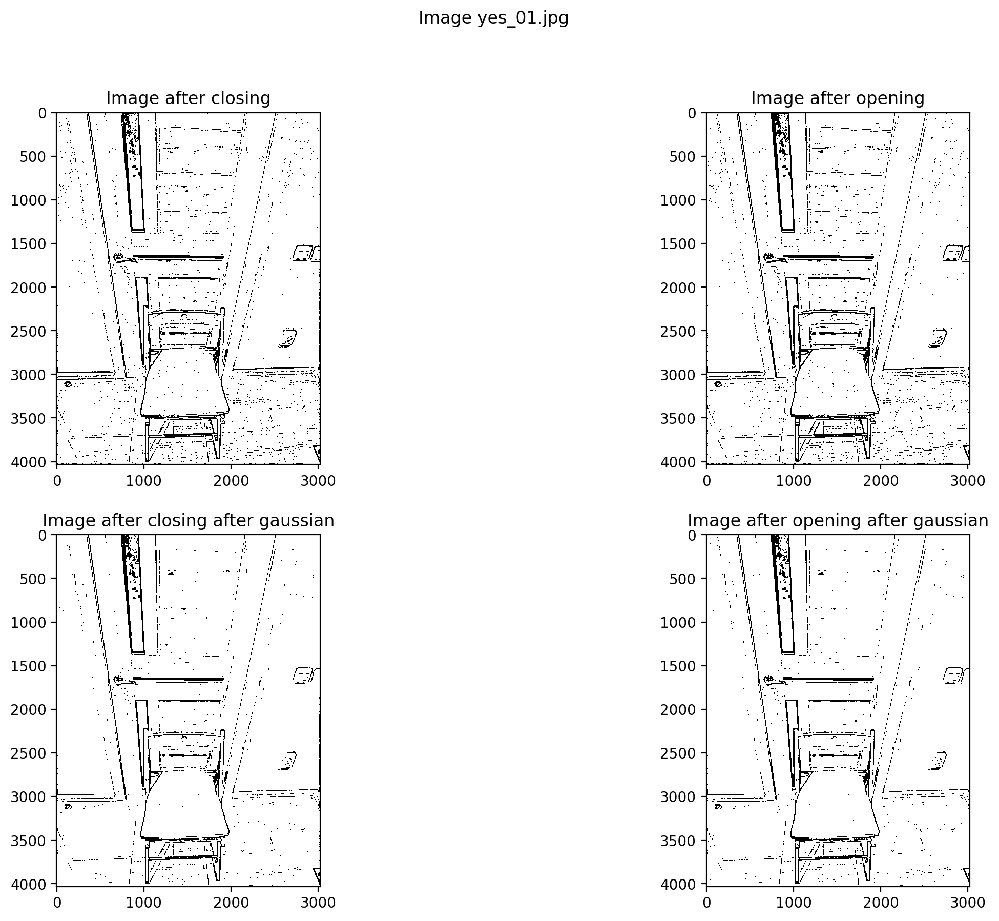

In [10]:
res_otsu_close_1 = binary_closing(img_loc_otsu, selem=np.ones((4, 4)))
res_otsu_open_1 = binary_opening(res_otsu_close_1, selem=np.ones((6, 6)))

img_loc_otsu_blur = gaussian(res_otsu_open_1, sigma=0.5, multichannel=True)

res_otsu_close_2 = binary_closing(img_loc_otsu_blur, selem=np.ones((3, 3)))
res_otsu_open_2 = binary_opening(res_otsu_close_2, selem=np.ones((6, 6)))

fig, ax = plt.subplots(2, 2, figsize=(15, 10))
fig.set_dpi(200)
fig.suptitle("Image %s" % name_img)
ax[0][0].set_title('Image after closing')
ax[0][0].imshow(res_otsu_close_1, cmap="gray")
ax[0][1].set_title('Image after opening')
ax[0][1].imshow(res_otsu_open_1, cmap="gray")
ax[1][0].set_title('Image after closing after gaussian')
ax[1][0].imshow(res_otsu_close_2, cmap="gray")
ax[1][1].set_title('Image after opening after gaussian')
ax[1][1].imshow(res_otsu_open_2, cmap="gray")

#### Преобразование Хафа

Функция нахождения преобразования Хафа и вывода результата на экран (позаимствована из второй мини-лабораторной)

In [11]:
def show_hough_transform(image):
    h, theta, d = hough_line(canny(image)) # вычисляем преобразование Хаффа от границ изображения

    fig, ax = plt.subplots(1, 3, figsize=(15, 6))

    ax[0].imshow(image, cmap=cm.gray)
    ax[0].set_title('Input image')
    ax[0].set_axis_off()

    ax[1].imshow(np.log(1 + h),
                 extent=[np.rad2deg(theta[-1]), np.rad2deg(theta[0]), d[-1], d[0]],
                 cmap='gray', aspect=1/20)
    ax[1].set_title('Hough transform')
    ax[1].set_xlabel('Angles (degrees)')
    ax[1].set_ylabel('Distance (pixels)')

    ax[2].imshow(image, cmap=cm.gray)
    for _, angle, dist in zip(*hough_line_peaks(h, theta, d)):
        y0 = (dist - 0 * np.cos(angle)) / np.sin(angle)
        y1 = (dist - image.shape[1] * np.cos(angle)) / np.sin(angle)
        ax[2].plot((0, image.shape[1]), (y0, y1), '-r')
    ax[2].set_xlim((0, image.shape[1]))
    ax[2].set_ylim((image.shape[0], 0))
    ax[2].set_axis_off()
    ax[2].set_title('Detected lines')

    plt.tight_layout()
    plt.show()

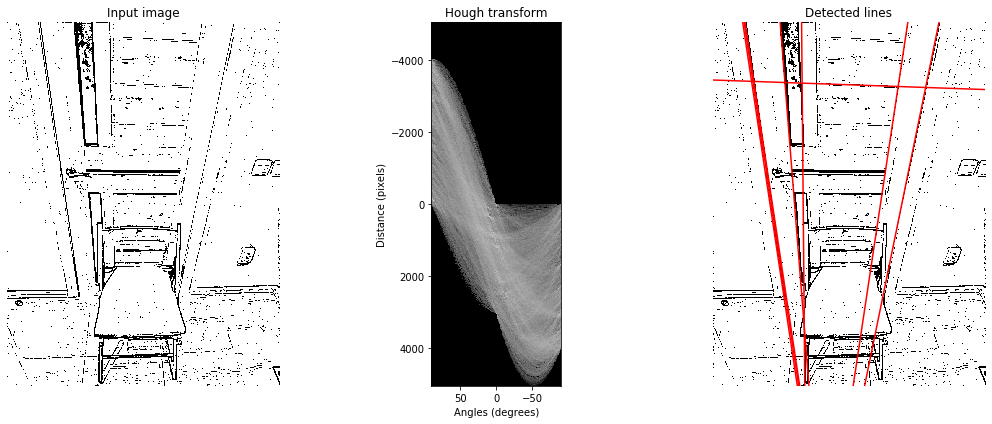

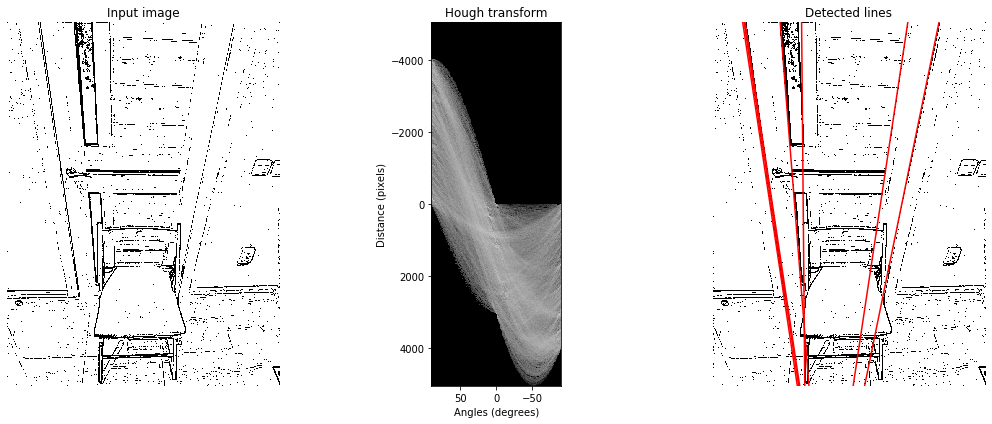

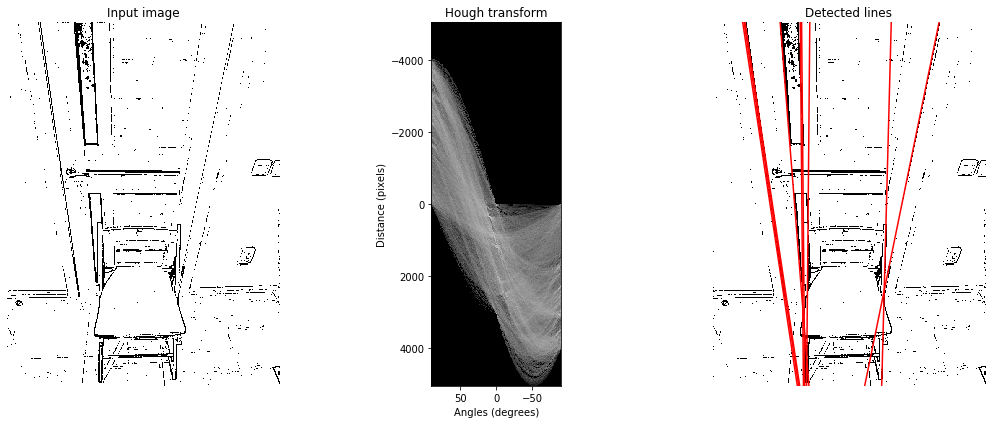

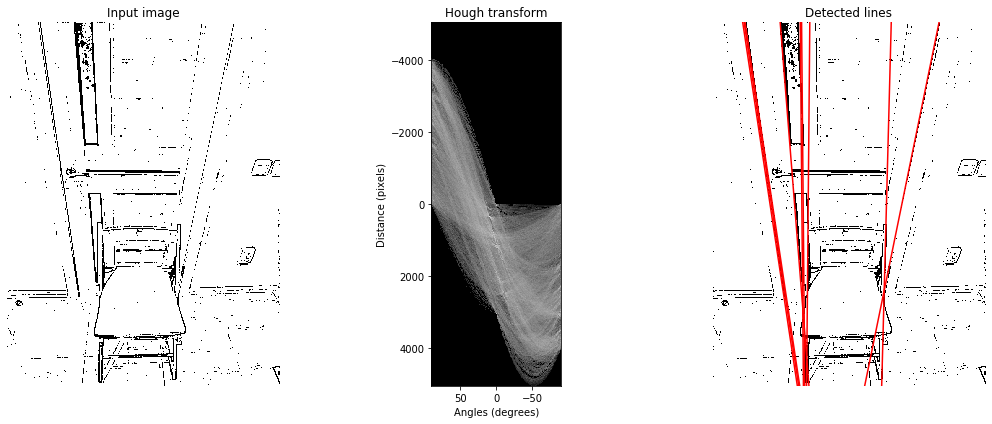

In [12]:
show_hough_transform(res_otsu_open_1)
show_hough_transform(res_otsu_close_1)
show_hough_transform(res_otsu_open_2)
show_hough_transform(res_otsu_close_2)

Алгоритм находит какие-то прямые, но сложно понять, какие именно относятся к дверному проёму

#### Вспомогательные функции

Функция находит границы изображения по маске. Возвращает границы прямоугольника, который описывает объект

In [13]:
def get_boundary(mask):
    horizon_indexes = np.where(np.any(mask, axis=0))[0]
    vertical_indexes = np.where(np.any(mask, axis=1))[0]
    
    left = horizon_indexes[0]
    right = horizon_indexes[-1]
    top = vertical_indexes[0]
    bottom = vertical_indexes[-1]
    
    rect_border = Rectangle((left, top), right - left, bottom - top, linewidth=3, edgecolor='c', facecolor='none')
    return rect_border

Функция обрезает изображение. Оставляет только то, что внутри границы

In [14]:
def crop_image_by_boundary(img, boundary):
    return img[boundary[0] : boundary[1], boundary[2] : boundary[3]]

Функция ищет совпадения на двух картинках ([большая часть позаимствована здесь (Example 26)](https://www.programcreek.com/python/example/89367/cv2.findHomography))

In [15]:
def find_matches_in_images(img1, img2):
    gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

    orb_detector = cv2.ORB_create(5000)

    kpt1, desc1 = orb_detector.detectAndCompute(gray1, None)
    kpt2, desc2 = orb_detector.detectAndCompute(gray2, None)

    matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = matcher.match(desc1, desc2)
    matches_length = len(matches)
    points1 = np.zeros((matches_length, 2))
    points2 = np.zeros((matches_length, 2))
    for i in range(matches_length):
        points1[i, :] = kpt1[matches[i].queryIdx].pt
        points2[i, :] = kpt2[matches[i].trainIdx].pt

    homography, mask = cv2.findHomography(points1, points2, cv2.RANSAC)
    
    fig, ax = plt.subplots(2, 2, figsize=(15, 10))
    fig.set_dpi(200)
    fig.suptitle("Looking for matches in the pictures")
    ax[0][0].set_title('What we are looking for')
    ax[0][0].imshow(gray1, cmap='gray')
    
    ax[0][1].set_title('Where we are looking')
    ax[0][1].imshow(gray2, cmap='gray')
    
    ax[1][0].set_title('What we are looking for')
    ax[1][0].imshow(gray1, cmap='gray')
    ax[1][0].plot(points1[:, 0], points1[:, 1], "co")
    
    ax[1][1].set_title('Where we are looking')
    ax[1][1].imshow(gray2, cmap='gray')
    ax[1][1].plot(points2[:, 0], points2[:, 1], "co")
    
    return homography, mask

#### Разметка границ стула

In [16]:
chair_name = "undef_04.jpg"
chair_img = imread("%s\\%s" % (data_path, chair_name))
chair_img_gray = rgb2gray(chair_img)

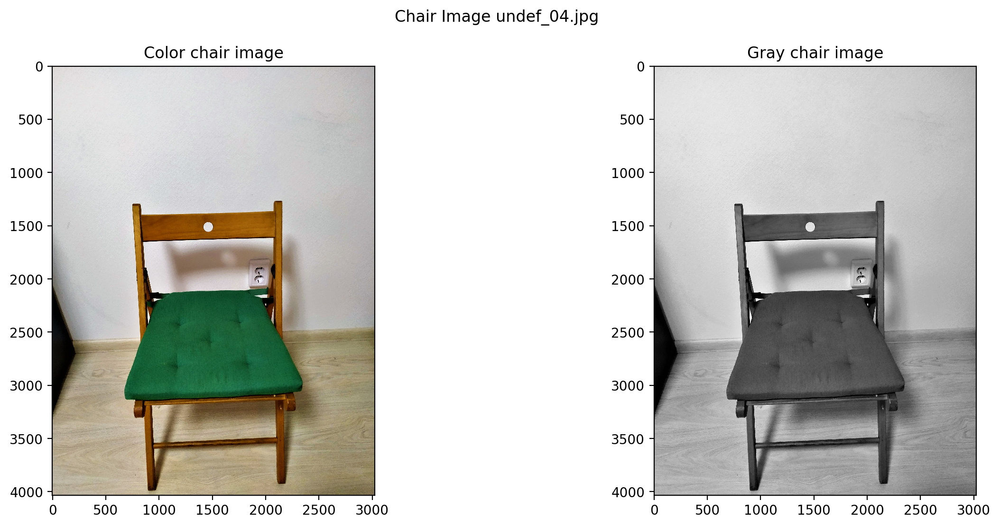

In [17]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6))
fig.set_dpi(200)  
fig.suptitle("Chair Image %s" % chair_name)
ax[0].set_title('Color chair image')
ax[0].imshow(chair_img)
ax[1].set_title('Gray chair image')
ax[1].imshow(chair_img_gray, cmap='gray')

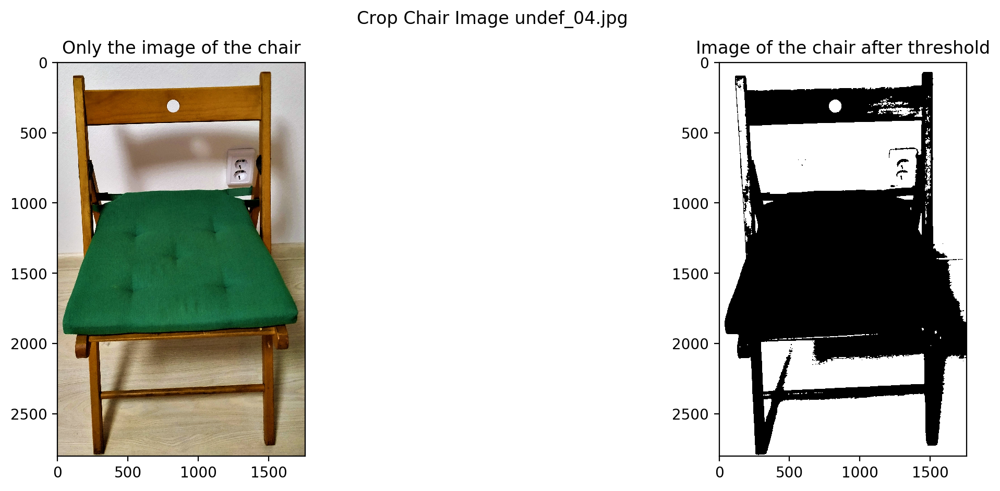

In [18]:
chair_boundary = [1200, 4000, 640, 2400]
chair_img_crop = crop_image_by_boundary(chair_img, chair_boundary)

chair_img_crop_gray = rgb2gray(chair_img_crop)
thresh = threshold_triangle(chair_img_crop_gray)
chair_img_crop_gray_binary = chair_img_crop_gray > thresh
chair_img_crop_gray_binary = binary_opening(chair_img_crop_gray_binary, selem=np.ones((5, 5)))
chair_img_crop_gray_binary = binary_closing(chair_img_crop_gray_binary, selem=np.ones((3, 3)))

fig, ax = plt.subplots(1, 2, figsize=(15, 5))
fig.set_dpi(200)  
fig.suptitle("Crop Chair Image %s" % chair_name)
ax[0].set_title('Only the image of the chair')
ax[0].imshow(chair_img_crop)
ax[1].set_title('Image of the chair after threshold')
ax[1].imshow(chair_img_crop_gray_binary, cmap="gray")

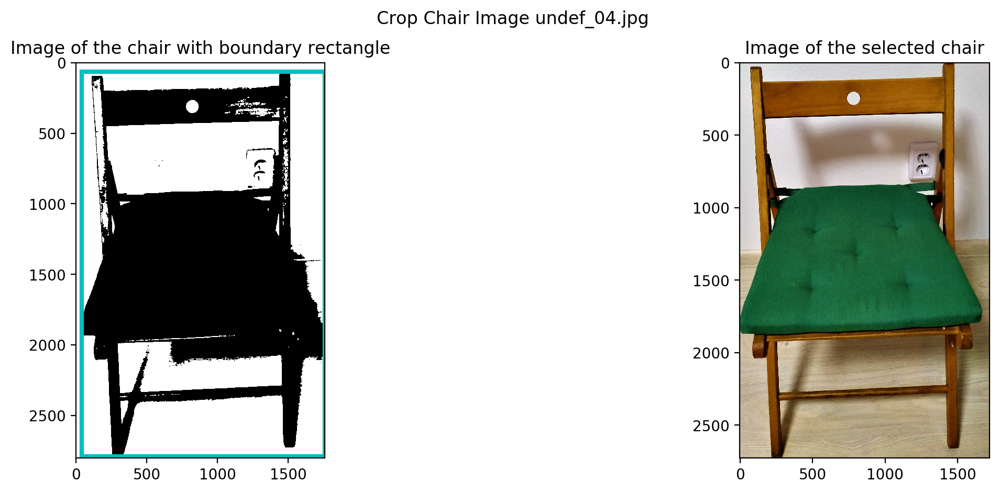

In [19]:
boundary = get_boundary(1 - chair_img_crop_gray_binary)
left = chair_boundary[2] + boundary.get_x()
right = chair_boundary[2] + boundary.get_x() + boundary.get_width()
top = chair_boundary[0] + boundary.get_y()
bottom = chair_boundary[0] + boundary.get_y() + boundary.get_height()

general_chair_boundary = [top, bottom, left, right]

fig, ax = plt.subplots(1, 2, figsize=(15, 5))
fig.set_dpi(200)  
fig.suptitle("Crop Chair Image %s" % chair_name)
ax[0].set_title('Image of the chair with boundary rectangle')
ax[0].imshow(chair_img_crop_gray_binary, cmap="gray")
ax[0].add_patch(boundary)
ax[1].set_title('Image of the selected chair')
ax[1].imshow(crop_image_by_boundary(chair_img, general_chair_boundary))

#### Разметка границ двери

In [20]:
door_name = "undef_02.jpg"
door_img = imread("%s\\%s" % (data_path, door_name))
door_img_gray = rgb2gray(door_img)

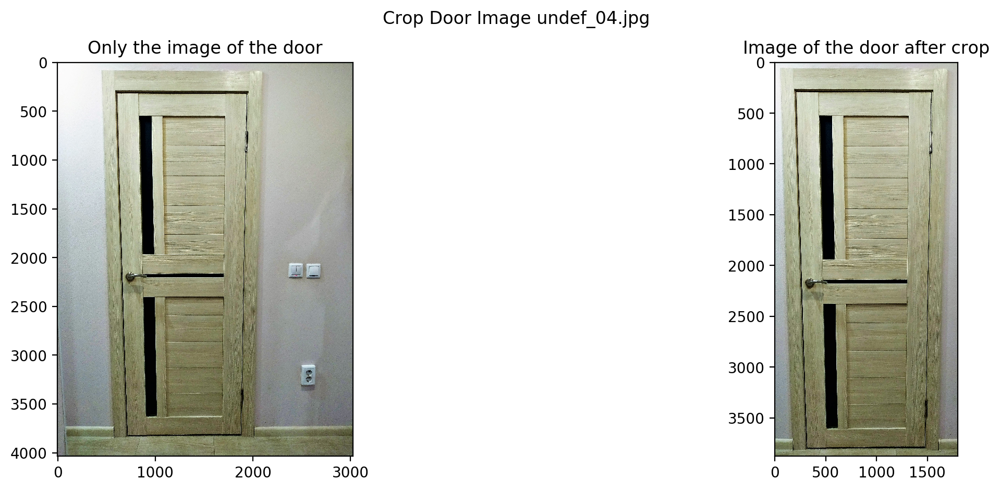

In [21]:
general_door_boundary = [25, 3900, 400, 2200]
door_img_crop = crop_image_by_boundary(door_img, general_door_boundary)

fig, ax = plt.subplots(1, 2, figsize=(15, 5))
fig.set_dpi(200)  
fig.suptitle("Crop Door Image %s" % chair_name)
ax[0].set_title('Only the image of the door')
ax[0].imshow(door_img)
ax[1].set_title('Image of the door after crop')
ax[1].imshow(door_img_crop)

#### Ищем стул на изображении стула с дверью

In [22]:
def select_object(img, tmp_img):
    homography, mask = find_matches_in_images(tmp_img, img)
    
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    tmp_img_gray = cv2.cvtColor(tmp_img, cv2.COLOR_BGR2GRAY)
    
    tmp_white = np.ones(tmp_img.shape)
    height, width = img_gray.shape
    
    tmp_img_mask = cv2.warpPerspective(tmp_white, homography, (width, height))
    tmp_new_img = cv2.warpPerspective(tmp_img, homography, (width, height))
    
    fig.set_dpi(200)  
    fig.suptitle("Find matches")
    ax[0].set_title('What')
    ax[0].imshow(tmp_img_gray, cmap='gray')
    ax[0].add_patch(get_boundary(tmp_white))
    ax[1].set_title('Where')
    ax[1].imshow(img_gray, cmap='gray')
    ax[1].add_patch(get_boundary(tmp_img_mask))

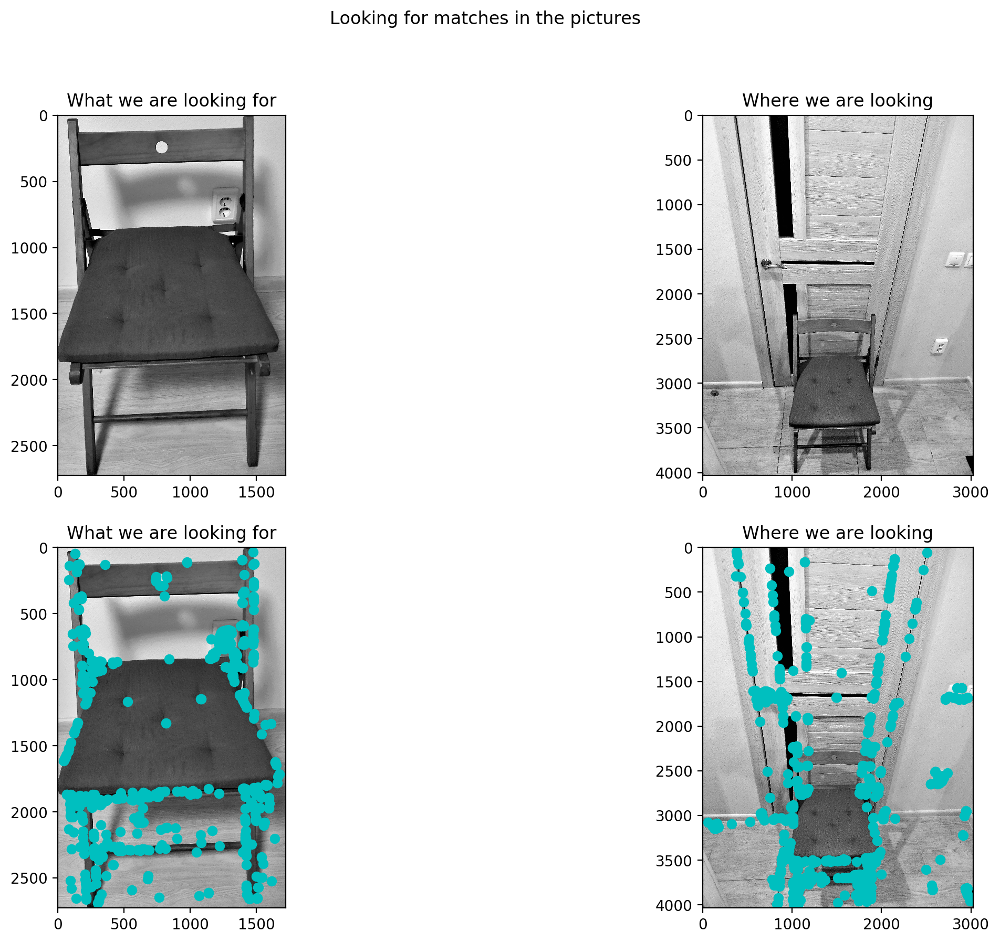

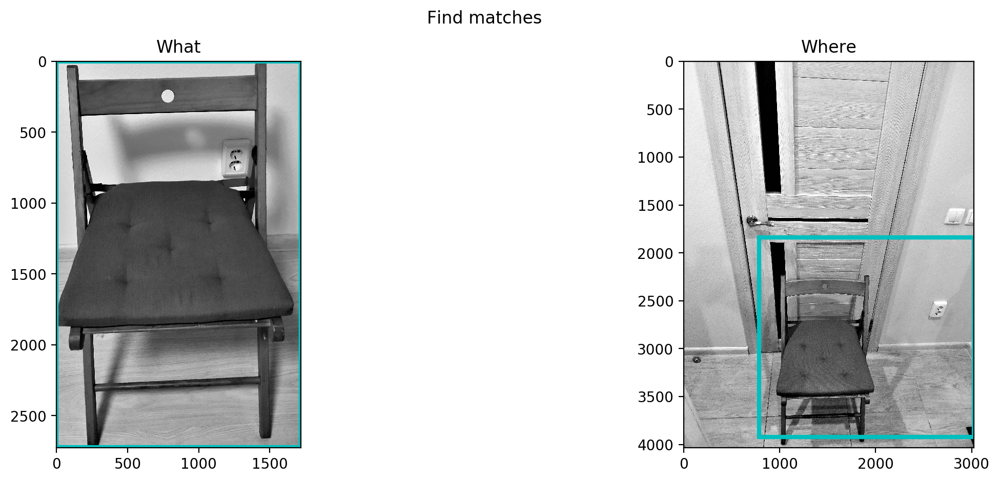

In [23]:
chair_name = "undef_04.jpg"
data_name = "yes_01.jpg"
data_img = cv2.imread("%s\\%s" % (data_path, data_name))
chair_img = cv2.imread("%s\\%s" % (data_path, chair_name))
chair_img = crop_image_by_boundary(chair_img, general_chair_boundary)

homography, mask = find_matches_in_images(chair_img, data_img)

chair_img_gray = cv2.cvtColor(chair_img, cv2.COLOR_BGR2GRAY)
data_img_gray = cv2.cvtColor(data_img, cv2.COLOR_BGR2GRAY)

chair_white = np.ones(chair_img.shape)
height, width = data_img_gray.shape
chair_mask = cv2.warpPerspective(chair_white, homography, (width, height))
chair_new_img = cv2.warpPerspective(chair_img, homography, (width, height))

fig, ax = plt.subplots(1, 2, figsize=(15, 5))
fig.set_dpi(200)  
fig.suptitle("Find matches")
ax[0].set_title('What')
ax[0].imshow(chair_img_gray, cmap='gray')
ax[0].add_patch(get_boundary(chair_white))
ax[1].set_title('Where')
ax[1].imshow(data_img_gray, cmap='gray')
ax[1].add_patch(get_boundary(chair_mask))

#### Ищем дверь на изображении стула с дверью

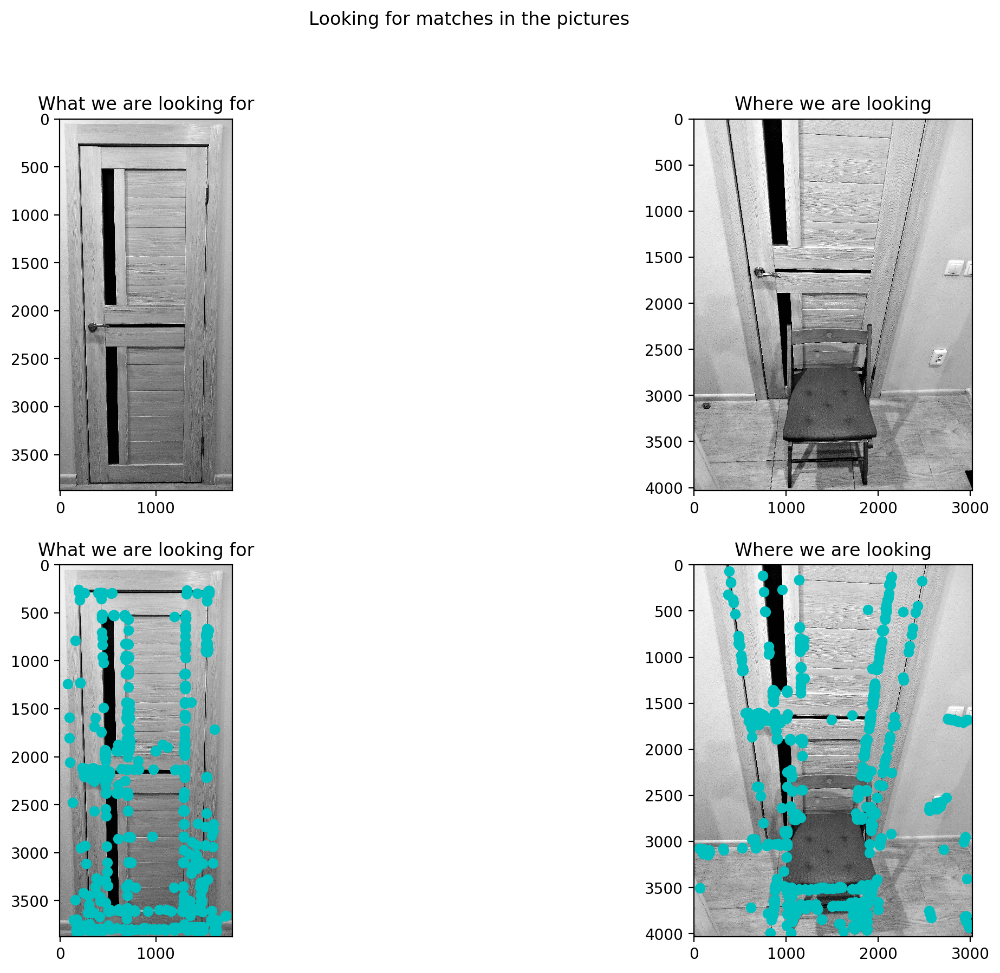

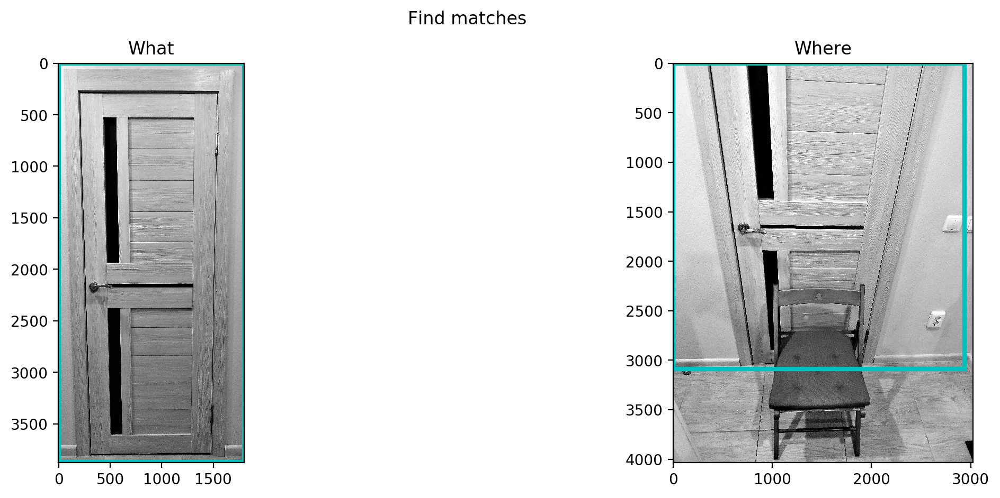

In [24]:
door_name = "undef_02.jpg"
data_name = "yes_01.jpg"
data_img = cv2.imread("%s\\%s" % (data_path, data_name))
door_img = cv2.imread("%s\\%s" % (data_path, door_name))
door_img = crop_image_by_boundary(door_img, general_door_boundary)

homography, mask = find_matches_in_images(door_img, data_img)

door_img_gray = cv2.cvtColor(door_img, cv2.COLOR_BGR2GRAY)
data_img_gray = cv2.cvtColor(data_img, cv2.COLOR_BGR2GRAY)

door_white = np.ones(door_img.shape)
height, width = data_img_gray.shape
door_mask = cv2.warpPerspective(door_white, homography, (width, height))
door_new_img = cv2.warpPerspective(door_img, homography, (width, height))

fig, ax = plt.subplots(1, 2, figsize=(15, 5))
fig.set_dpi(200)  
fig.suptitle("Find matches")
ax[0].set_title('What')
ax[0].imshow(door_img_gray, cmap='gray')
ax[0].add_patch(get_boundary(door_white))
ax[1].set_title('Where')
ax[1].imshow(data_img_gray, cmap='gray')
ax[1].add_patch(get_boundary(door_mask))

Переведем дверь и стул в пространство без перспективы

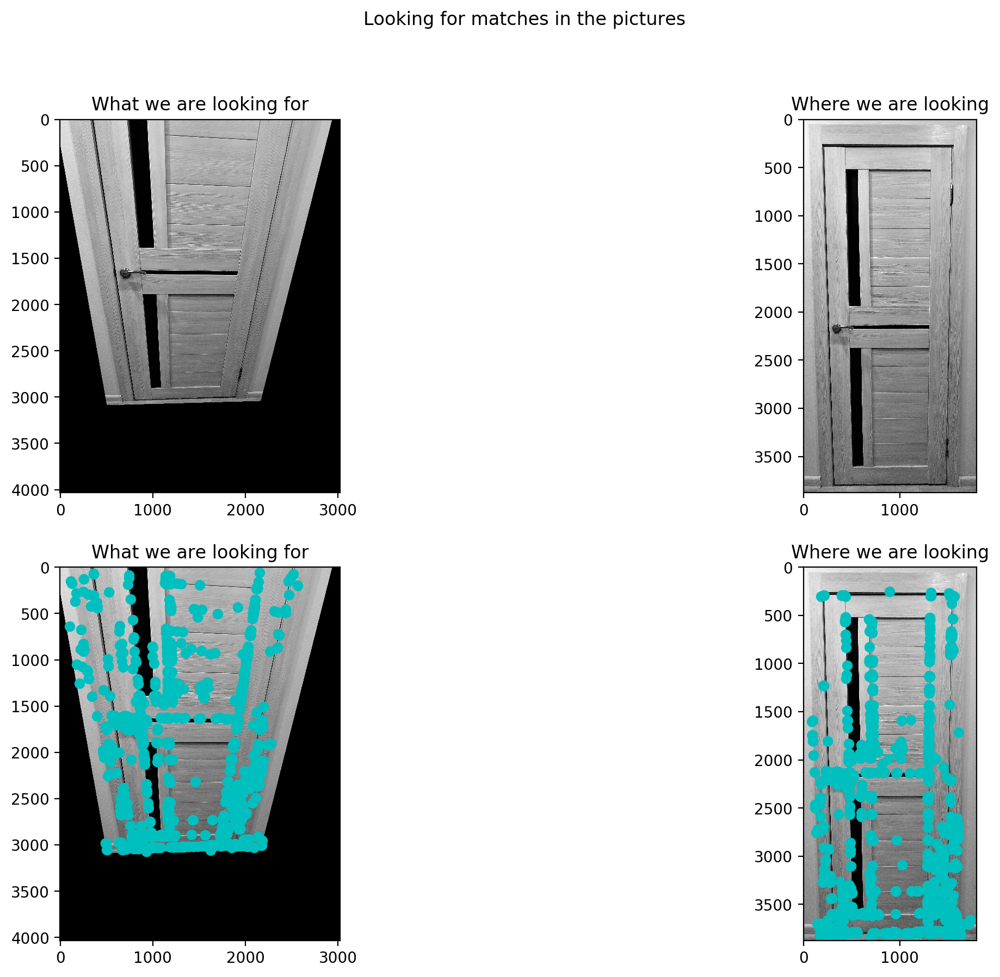

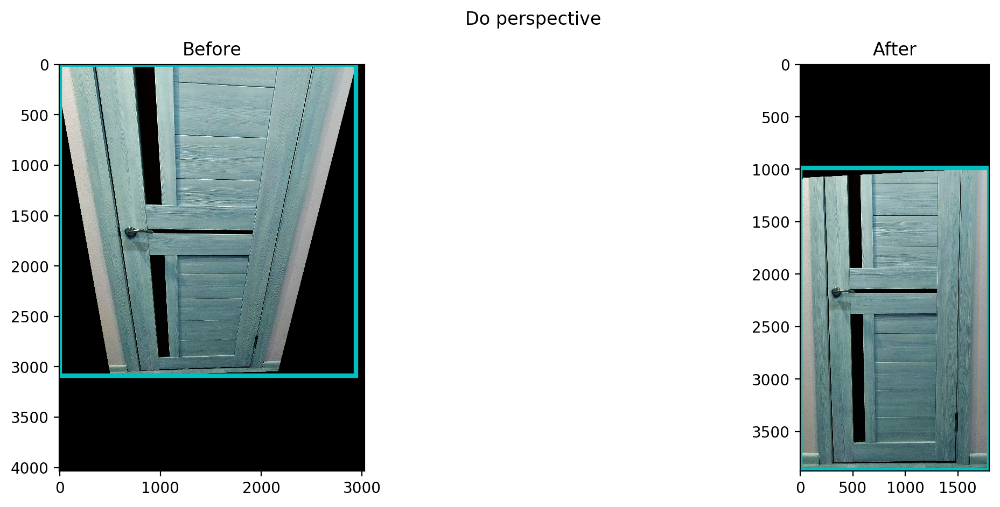

In [25]:
height, width = door_img_gray.shape

homography, mask = find_matches_in_images(door_new_img, door_img)
door_no_perspective_mask = cv2.warpPerspective(door_mask, homography, (width, height))
door_no_perspective_img = cv2.warpPerspective(door_new_img, homography, (width, height))

fig, ax = plt.subplots(1, 2, figsize=(15, 5))
fig.set_dpi(200)  
fig.suptitle("Do perspective")
ax[0].set_title('Before')
ax[0].imshow(door_new_img)
ax[0].add_patch(get_boundary(door_mask))

ax[1].set_title('After')
ax[1].imshow(door_no_perspective_img)
ax[1].add_patch(get_boundary(door_no_perspective_mask))

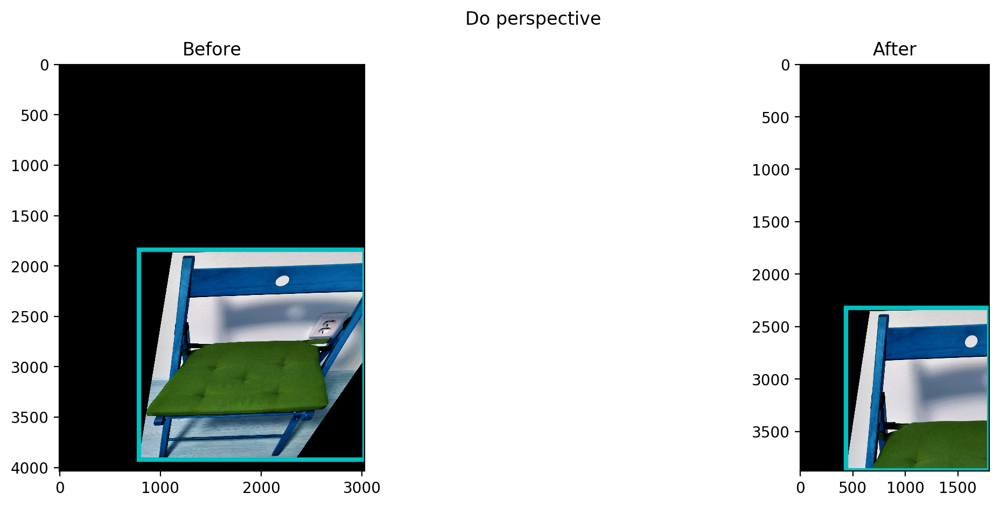

In [26]:
chair_no_perspective_mask = cv2.warpPerspective(chair_mask, homography, (width, height))
chair_no_perspective_img = cv2.warpPerspective(chair_new_img, homography, (width, height))

fig, ax = plt.subplots(1, 2, figsize=(15, 5))
fig.set_dpi(200)  
fig.suptitle("Do perspective")
ax[0].set_title('Before')
ax[0].imshow(chair_new_img, cmap='gray')
ax[0].add_patch(get_boundary(chair_mask))
ax[1].set_title('After')
ax[1].imshow(chair_no_perspective_img, cmap='gray')
ax[1].add_patch(get_boundary(chair_no_perspective_mask))

Yes, the chair goes through the door


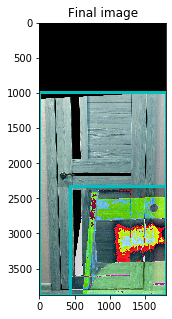

In [27]:
fig, ax = plt.subplots(1, 1, figsize=(15, 5))
ax.set_title('Final image')

ax.imshow(chair_no_perspective_img + door_no_perspective_img, cmap='gray')
chair_no_perspective_border = get_boundary(chair_no_perspective_mask)
ax.add_patch(chair_no_perspective_border)
door_no_perspective_border = get_boundary(door_no_perspective_mask)
ax.add_patch(door_no_perspective_border)

if(door_no_perspective_border.get_width() > chair_no_perspective_border.get_width()):
    print("Yes, the chair goes through the door")
else:
    print("No, the chair does not go through the door")